# Robust Cross-Validated VAR-LiNGAM

## 1. Setup and Data Preparation
This section imports necessary libraries and custom functions for data preprocessing, plotting, causal discovery, and evaluation.


In [1]:
import pandas as pd
import numpy as np
import time

print([np.__version__, pd.__version__])
np.set_printoptions(precision=3, suppress=True)


from src.data_preprocessing import preprocess_data
from src.plotting import plot_time_series, plot_heatmap, plot_causal_graph
from src.causal_matrix_evaluation import evaluate_causal_matrices, interpret_evaluation_metrics
from src.run_causal_discovery import run_varlingam, run_pcmci
from src.robust_varlingam import run_rcv_varlingam, grid_search_rcv_varlingam
from src.robust_pcmci import run_rcv_pcmci, grid_search_rcv_pcmci

['1.24.4', '2.0.3']


## 2. Causal Discovery Algorithms and Execution
Here we introduce and execute our causal discovery algorithms to get the correlation matrices and visualise the results.

### 2.1 VAR-LiNGAM (Vector Autoregressive Linear Non-Gaussian Acyclic Model)
VAR-LiNGAM is a causal discovery algorithm that estimates a linear non-Gaussian acyclic model from time series data. It is based on the principle of independent component analysis (ICA) and is designed to identify the causal relationships between variables in a multivariate time series.

### 2.2 PCMCI (Peter and Clark Momentary Conditional Independence)
PCMCI is a causal discovery algorithm that estimates causal relationships between variables in a multivariate time series using conditional independence tests. It is based on the principle of Granger causality and can identify both linear and non-linear causal relationships.


dataset shape: (1000, 5)


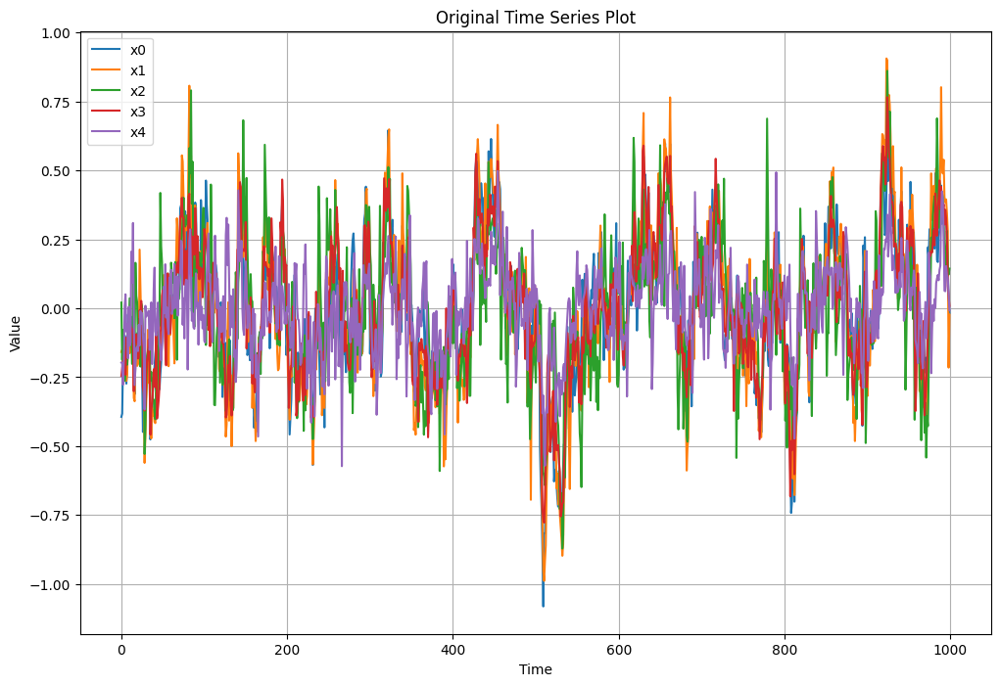

Adjacency matrices:  [[[ 0.     0.     0.     0.677  0.   ]
  [ 0.412  0.     0.281  0.22   0.   ]
  [ 0.     0.     0.     0.395  0.   ]
  [ 0.     0.     0.     0.     0.   ]
  [ 0.     0.221 -0.087  0.     0.   ]]

 [[ 0.419  0.    -0.183  0.     0.091]
  [ 0.     0.266  0.     0.     0.   ]
  [ 0.     0.     0.538  0.     0.   ]
  [ 0.165  0.14   0.     0.633 -0.122]
  [ 0.     0.    -0.182  0.223  0.381]]]


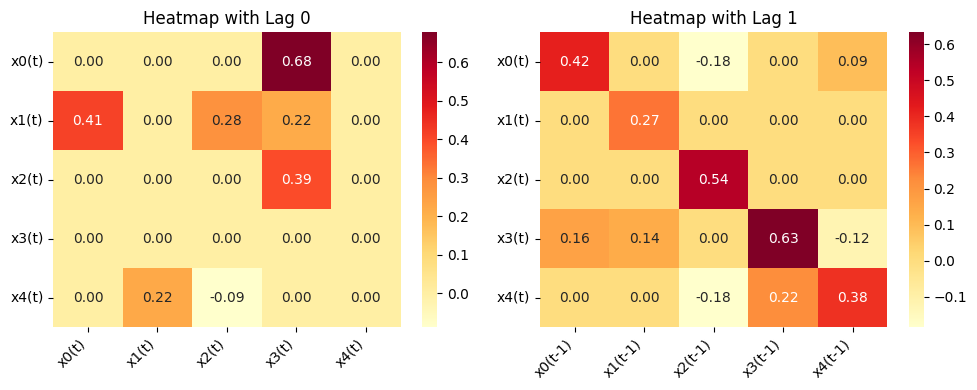

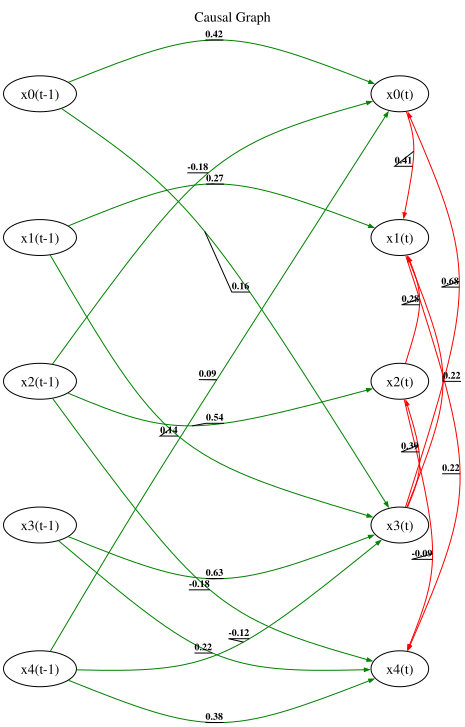

Execution time: 0.2015702724456787 seconds


In [2]:
### Load data ###
data = pd.read_csv('data/artificial/test_data.csv')
columns = data.columns.tolist()
if "Date" in columns:
    data = data.drop(['Date'], axis = 1).values
    columns.remove('Date')
else:
    data = data.values
print("dataset shape:", data.shape)
plot_time_series(data, columns, title="Original Time Series Plot")

### Data preprocessing ###
log_vars = None
percent_vars = None
# log_vars = ['C', 'I', 'Y', 'P']     # Variables to log-transform
# percent_vars = ['U', 'R']         # Variables to convert to percentages

data = preprocess_data(data, columns, log_vars=log_vars, percent_vars=percent_vars)
# np.savetxt('preprocessed_data.csv', data, delimiter=',')


### Run causal discovery method ###
method = "varlingam"  # 'pcmci' or 'varlingam'

# Run chosen method and plot results
start_time = time.time()
if method == 'pcmci':
    adjacency_matrices = run_pcmci(data, columns)
    end_time = time.time()
    
    print("Adjacency matrices: ", adjacency_matrices)
    plot_heatmap(adjacency_matrices, columns)
    causal_graph = plot_causal_graph(adjacency_matrices, node_labels=columns)
    display(causal_graph)
elif method == 'varlingam':
    results = run_varlingam(data)
    end_time = time.time()
    
    print("Adjacency matrices: ", results.adjacency_matrices_)
    plot_heatmap(results.adjacency_matrices_, columns)
    causal_graph = plot_causal_graph(results.adjacency_matrices_, node_labels=columns)
    display(causal_graph)
else:
    print("Invalid method chosen")
    exit()

print(f"Execution time: {end_time - start_time} seconds")

## 3. Model Evaluation and Optimization
This section focuses on evaluating our models and optimizing their performance.

### 3.1 Comparison of Standard and Robust Cross-Validated VAR-LiNGAM

Dataset shape: (1000, 5)


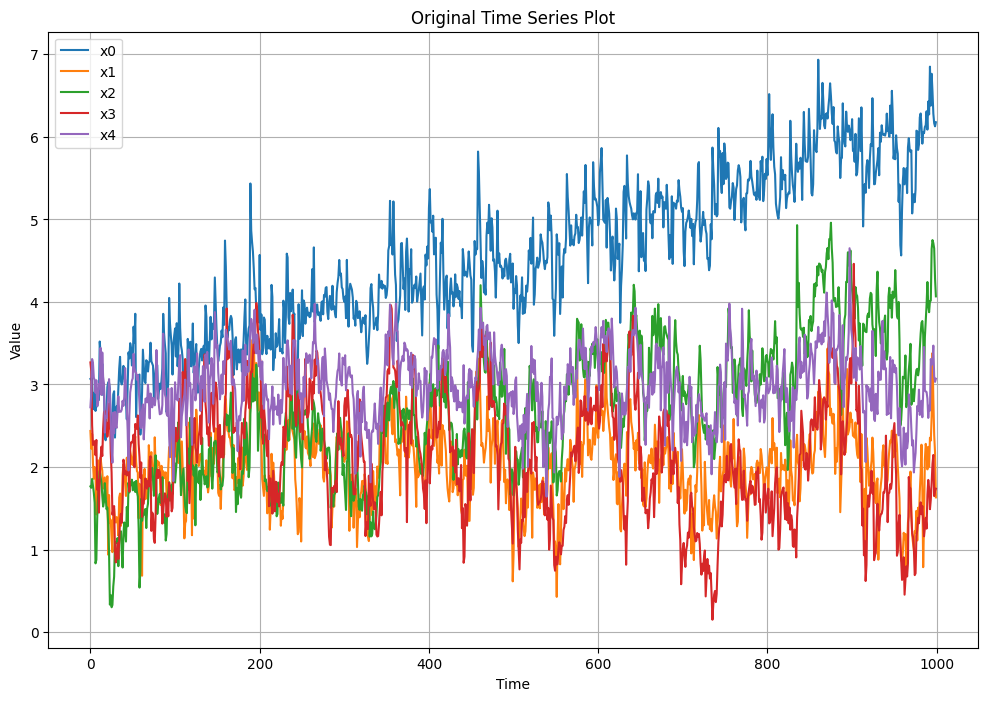


Standard VAR-LiNGAM Results:
True combined: 
 [[0.  0.  0.  0.  0.  0.6 0.  0.1 0.  0. ]
 [0.4 0.  0.  0.  0.  0.  0.5 0.  0.1 0. ]
 [0.  0.3 0.  0.  0.  0.  0.  0.7 0.  0. ]
 [0.1 0.  0.2 0.  0.  0.  0.  0.  0.8 0. ]
 [0.2 0.  0.  0.1 0.  0.  0.  0.2 0.  0.4]]
Est combined: 
 [[ 0.     0.     0.     0.     0.     0.664 -0.093  0.192 -0.009 -0.097]
 [ 0.408  0.     0.     0.     0.    -0.065  0.557 -0.075  0.09   0.097]
 [ 0.036  0.281  0.     0.     0.     0.     0.     0.719 -0.036  0.   ]
 [ 0.     0.115  0.116  0.     0.     0.     0.     0.     0.783  0.081]
 [ 0.124  0.113 -0.077  0.122  0.    -0.06   0.     0.227  0.     0.442]]
SHD:  14.0
Total elements:  14.0
SHD ratio:  1.0
[Frobenius Norm] Good: 0.354. Reasonable match between true and estimated matrices.
[Structural Hamming Distance] Poor: 14.0 (100.00%). Many structural differences.
[f1] Fair: 0.650. Moderate accuracy in identifying causal relationships.
[F1→] Good: 0.720. Good accuracy in identifying directed causal rela

In [3]:
# 1. Define ground truth matrices
B0_true = np.array([
    [0,   0,   0,   0,   0  ],
    [0.4, 0,   0,   0,   0  ],
    [0,   0.3, 0,   0,   0  ],
    [0.1, 0,   0.2, 0,   0  ],
    [0.2, 0,   0.,  0.1, 0  ]
])

B1_true = np.array([
    [0.6, 0,   0.1, 0,   0  ],
    [0,   0.5, 0,   0.1, 0  ],
    [0,   0,   0.7, 0,   0  ],
    [0,   0,   0,   0.8, 0  ],
    [0,   0,   0.2, 0,   0.4]
])

ground_truth_matrices = [B0_true, B1_true]

# 2. Load and preprocess data
def load_and_preprocess_data(file_path):
    data = pd.read_csv(file_path)
    if "Date" in data.columns:
        data = data.drop(['Date'], axis=1)
    return data.values, data.columns.tolist()

data_path = 'data/artificial/test_data_with_trends_random.csv'
data_values, variable_names = load_and_preprocess_data(data_path)

print(f"Dataset shape: {data_values.shape}")
plot_time_series(data_values, variable_names, title="Original Time Series Plot")

# 3. Run standard VAR-LiNGAM
varlingam_model = run_varlingam(data_values)
standard_varlingam_matrices = varlingam_model.adjacency_matrices_

print("\nStandard VAR-LiNGAM Results:")
standard_comparison = evaluate_causal_matrices(ground_truth_matrices, standard_varlingam_matrices)
standard_interpretations = interpret_evaluation_metrics(standard_comparison)
for metric, interpretation in standard_interpretations.items():
    print(f"[{metric}] {interpretation}")

# 4. Run Robust Cross-Validated VAR-LiNGAM
rcv_varlingam_matrices = run_rcv_varlingam(data_values)

print("\nRobust Cross-Validated VAR-LiNGAM Results:")
rcv_comparison = evaluate_causal_matrices(ground_truth_matrices, rcv_varlingam_matrices)
rcv_interpretations = interpret_evaluation_metrics(rcv_comparison)
for metric, interpretation in rcv_interpretations.items():
    print(f"[{metric}] {interpretation}")

# 5. Compare improvements
print("\nImprovement Analysis:")
for metric in ["fro", "shd", "f1", "f1_directed"]:
    standard_value = standard_comparison[metric]
    rcv_value = rcv_comparison[metric]
    
    if metric in ["fro", "shd"]:
        improvement = standard_value - rcv_value
        better_word = "decrease" if improvement > 0 else "increase"
    else:  # for f1 and weighted_f1
        improvement = rcv_value - standard_value
        better_word = "increase" if improvement > 0 else "decrease"
    
    print(f"{metric}: {better_word} of {abs(improvement):.4f}")
    print(f"  Standard: {standard_value:.4f}")
    print(f"  RCV     : {rcv_value:.4f}")
    
    if (metric in ["fro", "shd"] and improvement > 0) or (metric in ["f1", "f1_directed"] and improvement > 0):
        print("  Improvement: Yes")
    else:
        print("  Improvement: No")
    print()

#### Hyperparameter Optimization with Grid Search (RCV-VARLiNGAM)

In [ ]:
# Load and preprocess data
data_path = 'data/artificial/test_data_with_trends_random.csv'
data_values, variable_names = load_and_preprocess_data(data_path)

print(f"Dataset shape: {data_values.shape}")
plot_time_series(data_values, variable_names, title="Original Time Series Plot")

# Define true matrices (ground truth)
B0_true = np.array([
    [0,   0,   0,   0,   0  ],
    [0.4, 0,   0,   0,   0  ],
    [0,   0.3, 0,   0,   0  ],
    [0.1, 0,   0.2, 0,   0  ],
    [0.2, 0,   0.,  0.1, 0  ]
])

B1_true = np.array([
    [0.6, 0,   0.1, 0,   0  ],
    [0,   0.5, 0,   0.1, 0  ],
    [0,   0,   0.7, 0,   0  ],
    [0,   0,   0,   0.8, 0  ],
    [0,   0,   0.2, 0,   0.4]
])

true_matrices = [B0_true, B1_true]

# Perform grid search
grid_search_results = grid_search_rcv_varlingam(data_values, true_matrices)

print("\nBest parameters:")
for param, value in grid_search_results['best_params'].items():
    print(f"{param}: {value}")
print(f"Best Frobenius norm: {grid_search_results['best_score']:.4f}")

# Evaluate best matrices
best_matrices = grid_search_results['best_matrices']
evaluation_results = evaluate_causal_matrices(true_matrices, best_matrices)
interpretations = interpret_evaluation_metrics(evaluation_results)

print("\nBest RCV-VAR-LiNGAM Results:")
for metric, interpretation in interpretations.items():
    print(f"[{metric}] {interpretation}")

### 3.2 Comparison of Standard and Robust Cross-Validated PCMCI

Dataset shape: (1000, 5)


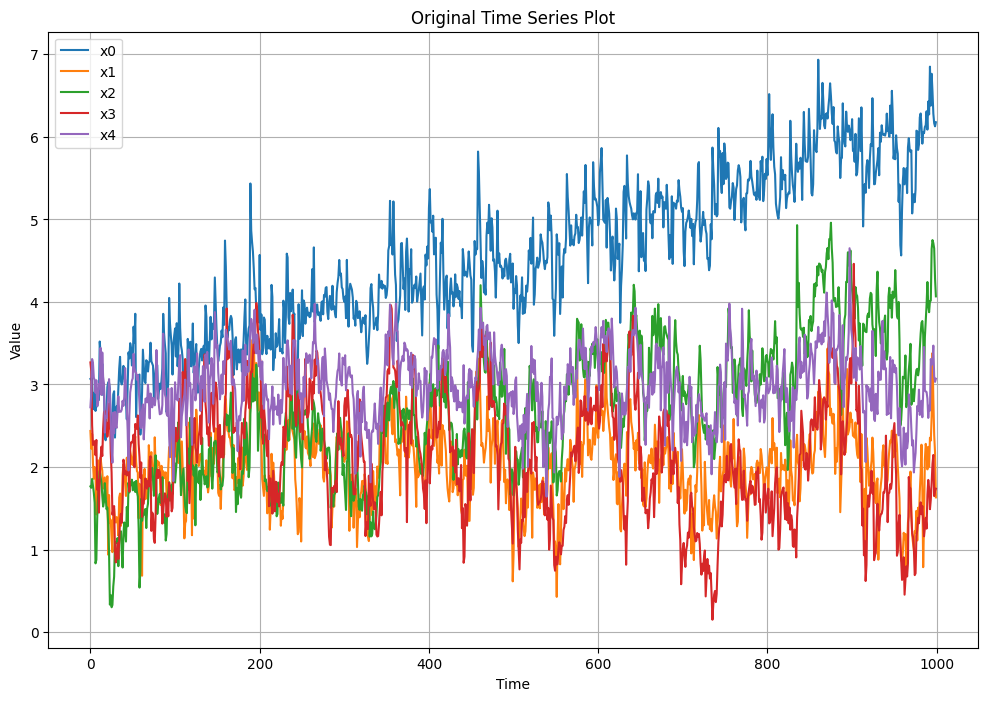


##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable 0 has 4 link(s):
        (0 -1): max_pval = 0.00000, |min_val| =  0.772
        (2 -1): max_pval = 0.00000, |min_val| =  0.198
        (1 -1): max_pval = 0.00000, |min_val| =  0.156
        (4 -1): max_pval = 0.00130, |min_val| =  0.102

    Variable 1 has 3 link(s):
        (1 -1): max_pval = 0.00000, |min_val| =  0.598
        (4 -1): max_pval = 0.00002, |min_val| =  0.134
        (3 -1): max_pval = 0.00043, |min_val| =  0.111

    Variable 2 has 3 link(s):
        (2 -1): max_pval = 0.00000, |min_val| =  0.766
        (0 -1): max_pval = 0.00000, |min_val| =  0.280
        (1 -1): max_pval = 0.00216, |min_val| =  0.097

    Variable 3 has 3 link(s):
        (3 -1): max_pval = 0.00000, |min_val| =  0.847
        (1 -1): max_pval = 0.00000, |m

In [3]:
# 1. Define ground truth matrices
B0_true = np.array([
    [0,   0,   0,   0,   0  ],
    [0.4, 0,   0,   0,   0  ],
    [0,   0.3, 0,   0,   0  ],
    [0.1, 0,   0.2, 0,   0  ],
    [0.2, 0,   0.,  0.1, 0  ]
])

B1_true = np.array([
    [0.6, 0,   0.1, 0,   0  ],
    [0,   0.5, 0,   0.1, 0  ],
    [0,   0,   0.7, 0,   0  ],
    [0,   0,   0,   0.8, 0  ],
    [0,   0,   0.2, 0,   0.4]
])

ground_truth_matrices = [B0_true, B1_true]

# 2. Load and preprocess data
def load_and_preprocess_data(file_path):
    data = pd.read_csv(file_path)
    if "Date" in data.columns:
        data = data.drop(['Date'], axis=1)
    return data.values, data.columns.tolist()

data_path = 'data/artificial/test_data_with_trends_random.csv'
data_values, variable_names = load_and_preprocess_data(data_path)

print(f"Dataset shape: {data_values.shape}")
plot_time_series(data_values, variable_names, title="Original Time Series Plot")

# 3. Run standard PCMCI
standard_pcmci_matrices = run_pcmci(data_values)

print("\nStandard PCMCI Results:")
standard_comparison = evaluate_causal_matrices(ground_truth_matrices, standard_pcmci_matrices)
standard_interpretations = interpret_evaluation_metrics(standard_comparison)
for metric, interpretation in standard_interpretations.items():
    print(f"[{metric}] {interpretation}")

# 4. Run Robust Cross-Validated VAR-LiNGAM
rcv_pcmci_matrices = run_rcv_pcmci(data_values)

print("\nRobust Cross-Validated PCMCI Results:")
rcv_comparison = evaluate_causal_matrices(ground_truth_matrices, rcv_pcmci_matrices)
rcv_interpretations = interpret_evaluation_metrics(rcv_comparison)
for metric, interpretation in rcv_interpretations.items():
    print(f"[{metric}] {interpretation}")

# 5. Compare improvements
print("\nImprovement Analysis:")
for metric in ["fro", "shd", "f1", "f1_directed"]:
    standard_value = standard_comparison[metric]
    rcv_value = rcv_comparison[metric]
    
    if metric in ["fro", "shd"]:
        improvement = standard_value - rcv_value
        better_word = "decrease" if improvement > 0 else "increase"
    else:  # for f1 and weighted_f1
        improvement = rcv_value - standard_value
        better_word = "increase" if improvement > 0 else "decrease"
    
    print(f"{metric}: {better_word} of {abs(improvement):.4f}")
    print(f"  Standard: {standard_value:.4f}")
    print(f"  RCV     : {rcv_value:.4f}")
    
    if (metric in ["fro", "shd"] and improvement > 0) or (metric in ["f1", "f1_directed"] and improvement > 0):
        print("  Improvement: Yes")
    else:
        print("  Improvement: No")
    print()

#### Hyperparameter Optimization with Grid Search (RCV-PCMCI)

Dataset shape: (1000, 5)


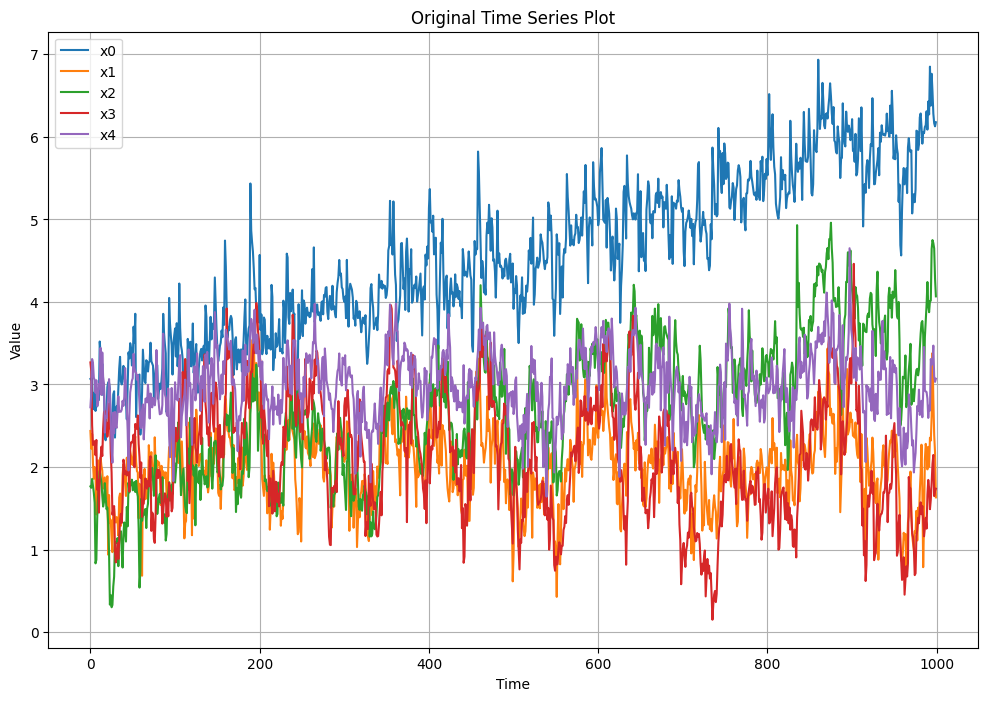


##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable 0 has 4 link(s):
        (0 -1): max_pval = 0.00000, |min_val| =  0.772
        (2 -1): max_pval = 0.00000, |min_val| =  0.198
        (1 -1): max_pval = 0.00000, |min_val| =  0.156
        (4 -1): max_pval = 0.00130, |min_val| =  0.102

    Variable 1 has 3 link(s):
        (1 -1): max_pval = 0.00000, |min_val| =  0.598
        (4 -1): max_pval = 0.00002, |min_val| =  0.134
        (3 -1): max_pval = 0.00043, |min_val| =  0.111

    Variable 2 has 3 link(s):
        (2 -1): max_pval = 0.00000, |min_val| =  0.766
        (0 -1): max_pval = 0.00000, |min_val| =  0.280
        (1 -1): max_pval = 0.00216, |min_val| =  0.097

    Variable 3 has 3 link(s):
        (3 -1): max_pval = 0.00000, |min_val| =  0.847
        (1 -1): max_pval = 0.00000, |m

In [4]:
# Load and preprocess data
data_path = 'data/artificial/test_data_with_trends_random.csv'
data_values, variable_names = load_and_preprocess_data(data_path)

print(f"Dataset shape: {data_values.shape}")
plot_time_series(data_values, variable_names, title="Original Time Series Plot")

# Define true matrices (ground truth)
B0_true = np.array([
    [0,   0,   0,   0,   0  ],
    [0.4, 0,   0,   0,   0  ],
    [0,   0.3, 0,   0,   0  ],
    [0.1, 0,   0.2, 0,   0  ],
    [0.2, 0,   0.,  0.1, 0  ]
])

B1_true = np.array([
    [0.6, 0,   0.1, 0,   0  ],
    [0,   0.5, 0,   0.1, 0  ],
    [0,   0,   0.7, 0,   0  ],
    [0,   0,   0,   0.8, 0  ],
    [0,   0,   0.2, 0,   0.4]
])

true_matrices = [B0_true, B1_true]

# Perform grid search
grid_search_results = grid_search_rcv_pcmci(data_values, true_matrices)

print("\nBest parameters:")
for param, value in grid_search_results['best_params'].items():
    print(f"{param}: {value}")
print(f"Best Frobenius norm: {grid_search_results['best_score']:.4f}")

# Evaluate best matrices
best_matrices = grid_search_results['best_matrices']
evaluation_results = evaluate_causal_matrices(true_matrices, best_matrices)
interpretations = interpret_evaluation_metrics(evaluation_results)

print("\nBest RCV-VAR-LiNGAM Results:")
for metric, interpretation in interpretations.items():
    print(f"[{metric}] {interpretation}")